## Github Setup
If not already present this clones the repo into google colab so that I may work on it with a bash environment.

In [0]:
from getpass import getpass
import os

!git config --global user.name "Richard Boyne"
!git config --global user.email "boynerichard@yahoo.co.uk"

# if not in a repo clone the desired one
if not os.path.isdir(".git"):
    
    # get username and password
    user = "Boyne272"
    password = getpass('github password')
    os.environ['GITHUB_AUTH'] = user + ':' + password
    
    # clone the repo
    !git clone --quiet https://$GITHUB_AUTH@github.com/msc-acse/acse-9-independent-research-project-Boyne272.git repo

    # move the repo directory up one
    !mv repo/.git .
    
    # swap to the wanted branch
    !git checkout post_processing --quiet
    
    # move to previous commit
    !git reset --quiet --hard
    
# remove the sample data if there
if os.path.isdir("sample_data"):
    !rm -r sample_data/

# remove the tmp repo folder if there
if os.path.isdir("repo"):    
    !rm -r repo
    
# show where we are
!git show --summary

github password··········
commit 3831373df74f2b4725faeea16e152dc9cec7b301 (HEAD -> post_processing, origin/post_processing)
Author: Richard Boyne <boynerichard@yahoo.co.uk>
Date:   Tue Aug 20 13:32:51 2019 +0000

    minor bug fix in Segment_Analyser as well as test implentation
    
    This is not the most full proof test but the module is quite small and independent so it is less critical as well as being dependent on all its predisesors so quite tough to test

 create mode 100644 pre_post_processing/test_Segment_Analyser.py


## Github Space
Use the cells here to run github commands

In [0]:
# !git checkout -b Release
# !git pull origin master
# !git pull origin merging
# !git checkout post_processing
# !git pull origin kmeans

In [0]:
!mv tmp.txt kmeans/test_MSLIC.py

In [0]:
!git status

On branch Release
Changes not staged for commit:
  (use "git add <file>..." to update what will be committed)
  (use "git checkout -- <file>..." to discard changes in working directory)

	modified:   kmeans/test_MSLIC.py
	modified:   kmeans/test_SLIC.py

no changes added to commit (use "git add" and/or "git commit -a")


In [0]:
!git add kmeans/test_MSLIC.py kmeans/test_SLIC.py

In [0]:
!git commit -m "fixed minor bugs introduced when linting"

[Release 7a3db34] fixed minor bugs introduced when linting
 2 files changed, 2 insertions(+), 2 deletions(-)


In [0]:
!git push origin Release

Counting objects: 5, done.
Delta compression using up to 2 threads.
Compressing objects: 100% (5/5), done.
Writing objects: 100% (5/5), 449 bytes | 449.00 KiB/s, done.
Total 5 (delta 4), reused 0 (delta 0)
remote: Resolving deltas: 100% (4/4), completed with 4 local objects.
To https://github.com/msc-acse/acse-9-independent-research-project-Boyne272.git
   a7b5ad8..7a3db34  Release -> Release


## Run Tests
Run all pytests here, try to do as often as possible

In [0]:
!pytest # last run 21st Aug

============================= test session starts ==============================
platform linux2 -- Python 2.7.15+, pytest-3.6.4, py-1.8.0, pluggy-0.7.1
rootdir: /content, inifile:
collected 24 items                                                             

kmeans/test_MSLIC.py ...                                                 [ 12%]
kmeans/test_SLIC.py .....                                                [ 33%]
merging/test_AGNES.py ...                                                [ 45%]
merging/test_Segments.py ........                                        [ 79%]
pre_post_processing/test_Image_processor.py ....                         [ 95%]
pre_post_processing/test_Segment_Analyser.py .                           [100%]

========================== 24 passed in 87.53 seconds ==========================


In [0]:
# -*- coding: utf-8 -*-
"""
Last updated on Wed Aug 21 16:47:25 2019

Part of the Automated Thin Section Analysis tool set

@author: Richard Bonye
"""

import unittest
import torch
import matplotlib.pyplot as plt

from MSLIC import MSLIC_wrapper
from tools import set_seed, get_img


class Test_MSLIC_wrapper(unittest.TestCase):
    """
    Tests for the MSLIC class. Note these are all unit tests as this is doing
    nothing new over the SLIC class (except for the distance combination
    which is tested below) hence results based tests are not needed
    """

    def test_distance_combination(self):
        """
        test that the img is converetd to vectors correctly and
        that the adjasent bins list makes sense
        """
        # setup
        set_seed(10)
        img_w = get_img("images/example_white.tif")
        img_p = get_img("images/example_polar.tif")
        obj = MSLIC_wrapper((img_w, img_p), [4, 4])

        # find the combined distance
        for slic_obj in obj.SLIC_objs:
            slic_obj._update_distances()
        combo_dist = obj._combined_distance()

        # test the combined distance is the correct shape
        assert all([a.shape == b.shape for a, b in
                    zip(combo_dist, obj.SLIC_objs[0].distances)]), \
            "combined distance must have the same shape as the " +\
            "distances for each SLIC object"

        assert all([a.shape == b.shape for a, b in
                    zip(combo_dist, obj.SLIC_objs[1].distances)]), \
            "combined distance must have the same shape as the " +\
            "distances for each SLIC object"

        # check the combined distance is different from the indevidual ones
        for combo, dist1, dist2 in zip(combo_dist,
                                       obj.SLIC_objs[0].distances,
                                       obj.SLIC_objs[1].distances):
            assert not (combo == dist1).all(), \
                "combined distance must be different to indevidual distances"
            assert not (combo == dist2).all(), \
                "combined distance must be different to indevidual distances"


    def test_assignment_to_slic(self):
        """
        test that MSLIC_wrapper is assigining the distances correctly
        and that the SLIC algorithms are continuing without error
        """
        # setup
        set_seed(10)
        img_w = get_img("images/example_white.tif")
        img_p = get_img("images/example_polar.tif")
        obj = MSLIC_wrapper((img_w, img_p), [4, 4])

        # iterate
        obj.iterate(1)

        # check both SLIC instances agree on the clustering
        assert all(obj.SLIC_objs[0].vec_clusts == \
                   obj.SLIC_objs[1].vec_clusts),\
            "both SLIC instances must agree on the clustering"

        # check the SLIC instances are still functional
        self.previous_slic(obj.SLIC_objs[0])
        self.previous_slic(obj.SLIC_objs[1])


    def previous_slic(self, obj):
        """
        use the SLIC tests after an iteration to ensure the assignment
        the MSLIC_wrapper does is not impeding its algorithm in any way
        """

        # test distance list makes sense
        assert len(obj.distances) == 16, "should be 16 bin distance tensors"

        assert obj.distances[0].dtype == torch.float32, \
            "vc_dists should be a tensor with float values"

        assert all([a.shape[0] == b.shape[0] for a, b in
                    zip(obj.distances, obj._bins_list)]), \
            "The number of distance measures in each bin must match the " +\
            "number of vectors in that bin"

        assert all([a.shape[1] == b.shape[0] for a, b in
                    zip(obj.distances, obj._adj_bins)]), \
            "The number of distance measures per vector must match the " +\
            "number of adjasent centers for that bin"

        # test clusters make sense
        assert sum([o.numel() for o in obj._cluster_contense]) == obj._np, \
            "clustered vectors needs to be same as number of pixels"

        assert obj.vec_clusts.unique().numel() == 16, \
            "should be exactly 16 clusters"

        # test the new cetroids are still inside the image domain
        # note the * here acts as an and opterator
        tmp = ((obj.centroids[:, 0] <= obj._dim_x) * (obj.centroids[:, 0] >= 0) *
               (obj.centroids[:, 1] <= obj._dim_y) * (obj.centroids[:, 1] >= 0) *
               (obj.centroids[:, 2] <= 1) * (obj.centroids[:, 2] >= 0) *
               (obj.centroids[:, 3] <= 1) * (obj.centroids[:, 3] >= 0) *
               (obj.centroids[:, 4] <= 1) * (obj.centroids[:, 4] >= 0))
        assert tmp.all(), "all pixel values must be in the image domian"


    def test_plot(self):
        """
        check that all the plot options run
        (Not perfect but better than nothing)
        """
        # setup
        set_seed(10)
        img_w = get_img("images/example_white.tif")
        img_p = get_img("images/example_polar.tif")
        obj = MSLIC_wrapper((img_w, img_p), [4, 4])

        # iterate
        obj.iterate(2)

        for opt in ['default', 'setup', 'edges', 'img', 'centers',
                    'bins', 'time', 'bin_edges', 'segments', 'setup']:
            obj.plot([0, 1], opt)
            plt.close('all')

        # check that plotting a just one instance also works
        obj.plot([0], 'default')
        obj.plot([1], 'default')


if __name__ == '__main__':

    # run all the tests if this is script is run independently
    test_obj = Test_MSLIC_wrapper()
    test_obj.test_distance_combination()
    test_obj.test_assignment_to_slic()
    test_obj.test_plot()
    print('\n all tests passed')

#     # unittest.main does not work in google colab, but should work elsewhere
#     unittest.main()


## Imports

In [0]:
# Ipython magic functions
%load_ext autoreload
%autoreload 2
%matplotlib inline

# path extensions
import sys
sys.path.insert(0, "/content/kmeans")
sys.path.insert(0, "/content/merging")
sys.path.insert(0, "/content/pre_post_processing")

In [0]:
# imports
import torch
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd 

# custom imports
from AGNES import AGNES
from Image_processor import Image_processor
from Segment_Analyser import Segment_Analyser
from SLIC import SLIC
from MSLIC import MSLIC_wrapper

## Development Space

## Playground

### Load and prep Images

In [0]:
# load data
IP_polar = Image_processor(path='/content/images/Texas/TX2_polar.tif')
IP_white = Image_processor(path='/content/images/Texas/TX2_white.tif')

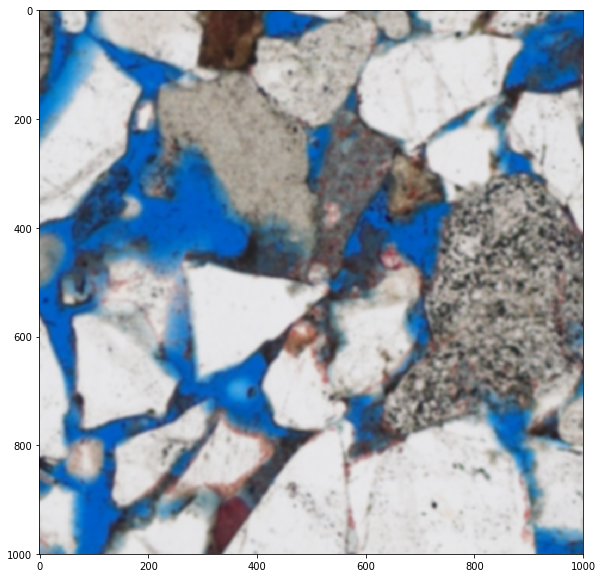

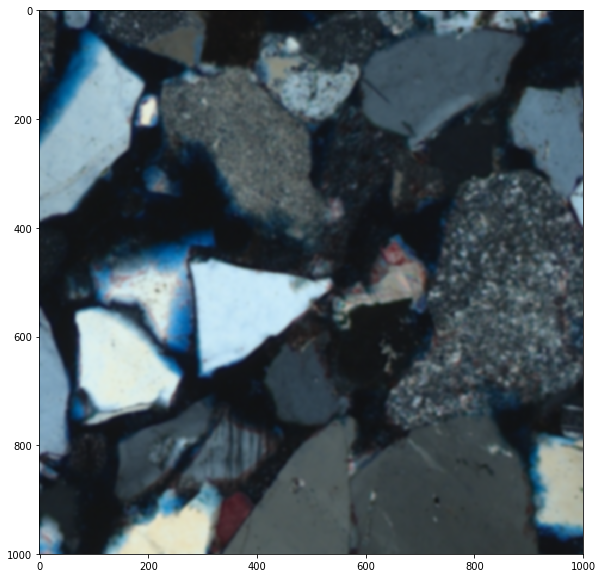

In [0]:
# guassian blur for color space
for IP in IP_white, IP_polar:
    IP.reset()
    IP.gauss(sigma=3, key='gauss')
    IP.plot('gauss')

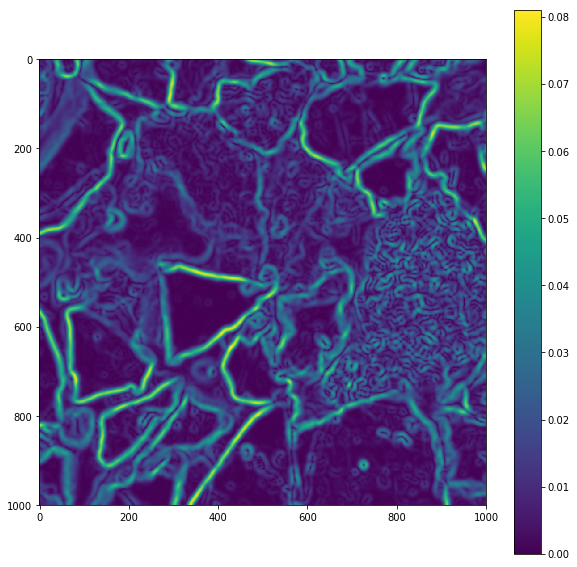

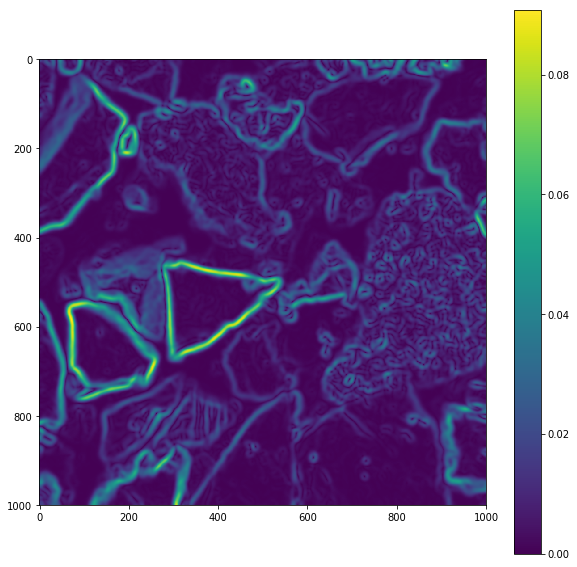

In [0]:
# scharr edge transform
for IP in IP_white, IP_polar:
    IP.reset()
    IP.gauss(sigma=5, key='curr')
    IP.scharr(key='curr')
    IP.grey_scale('scharr')
    IP.plot('scharr')

In [0]:
# # scharr edge transform
# for IP in IP_white, IP_polar:
#     IP.reset()
#     IP.gauss(sigma=3)
#     IP.scharr()
#     IP.grey_scale()
    
#     for _ in range(3):
#         IP.gauss(sigma=3)
#         IP.erosion()
        
#     IP.store('scharr')
#     IP.plot()        

In [0]:
# # prewitt edge transform
# for IP in IP_white, IP_polar:
#     IP.reset()
#     IP.gauss(sigma=2)
#     IP.grey_scale()
#     IP.prewitt('prewitt')
#     IP.plot('prewitt')

In [0]:
# find hsv gaussian blurs
# for IP in IP_white, IP_polar:
#     IP.reset()
#     IP.hsv()
#     IP.gauss(sigma=3, key='gauss hsv')
#     IP.plot('gauss hsv')

In [0]:
# # canny blur
# for IP in IP_white, IP_polar:
#     IP.reset()
#     IP.grey_scale()
#     IP.canny()
#     IP.gauss(sigma=2)
#     IP.gauss(sigma=2, key='cany_blur')
#     IP.plot()

In [0]:
# # # segments gradients
# for IP in IP_white, IP_polar:
#     IP.reset()
#     IP.grey_scale()
#     IP.median(size=5)
#     IP.gauss(sigma=5)
#     IP.laplace(size=5)
#     IP.dilation(size=5, key='lap')
# #     IP.threshold(-0.1, 0.1, key='lap')
# #     IP.normalise('lap', std=.5)
#     IP.plot('lap')

In [0]:
# # # calculate texture properties
# for IP in IP_white, IP_polar:
#     IP.gabor_filters(frequency=2, n_angs=5)
#     IP.grey_scale()
#     IP.normalise('gabor', std=.5)
#     IP.plot('gabor')

### Over Segment

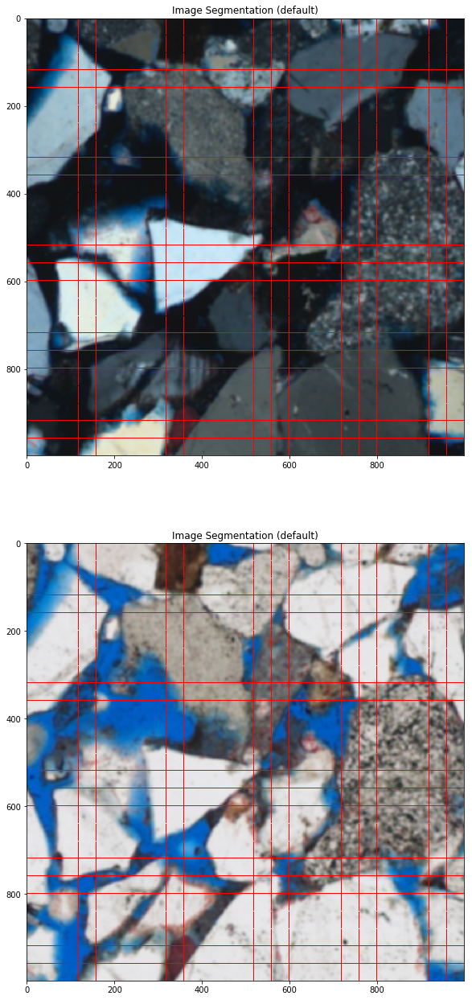

In [0]:
imgs = IP_polar.imgs['gauss'], IP_white.imgs['gauss']
MSLIC_obj = MSLIC_wrapper(imgs, bin_grid=[25, 25])

Progress |###################################################| 155.3230 s

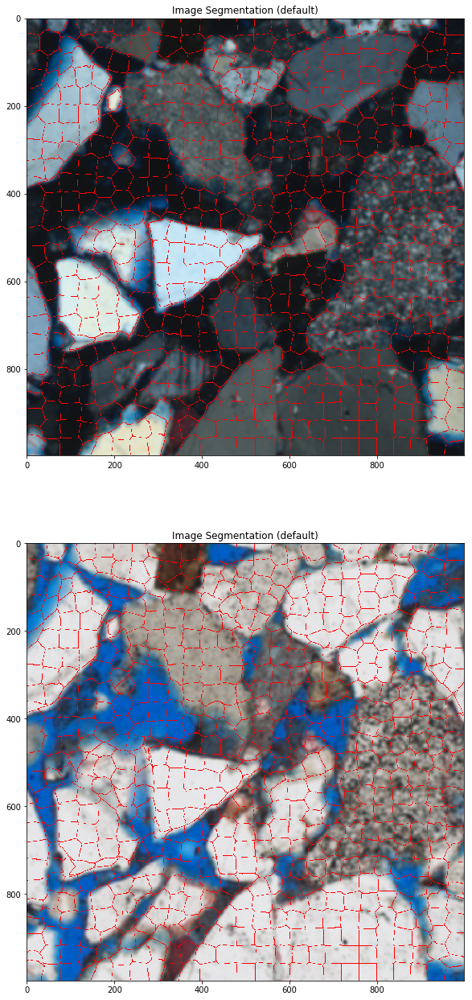

In [0]:
MSLIC_obj.iterate(10)
MSLIC_obj.plot()

In [0]:
# extract the mask
mask = MSLIC_obj.get_segmentation()

### Create segments

In [0]:
# initalise segement object and remove small grains
segment_obj = segment_group(mask)
segment_obj.enforce_size(min_size=50)

Initalising 632 segments
Progress |###################################################| 51.5353 s

7 segments merged
Initalising 38 segments
Progress |###################################################| 3.0766 s



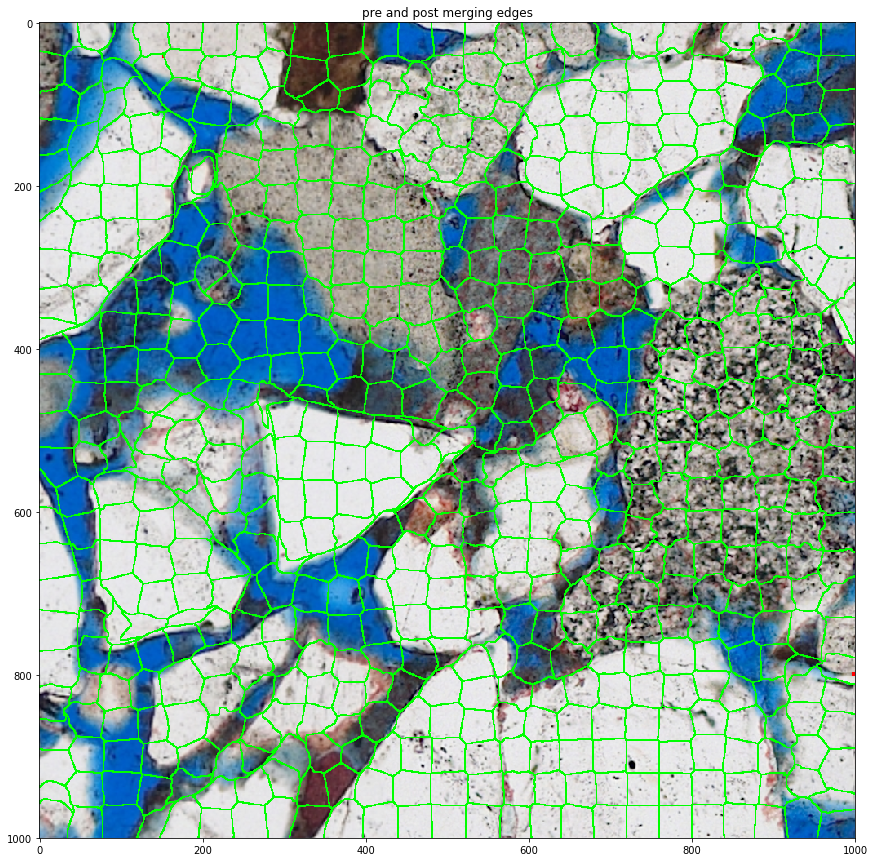

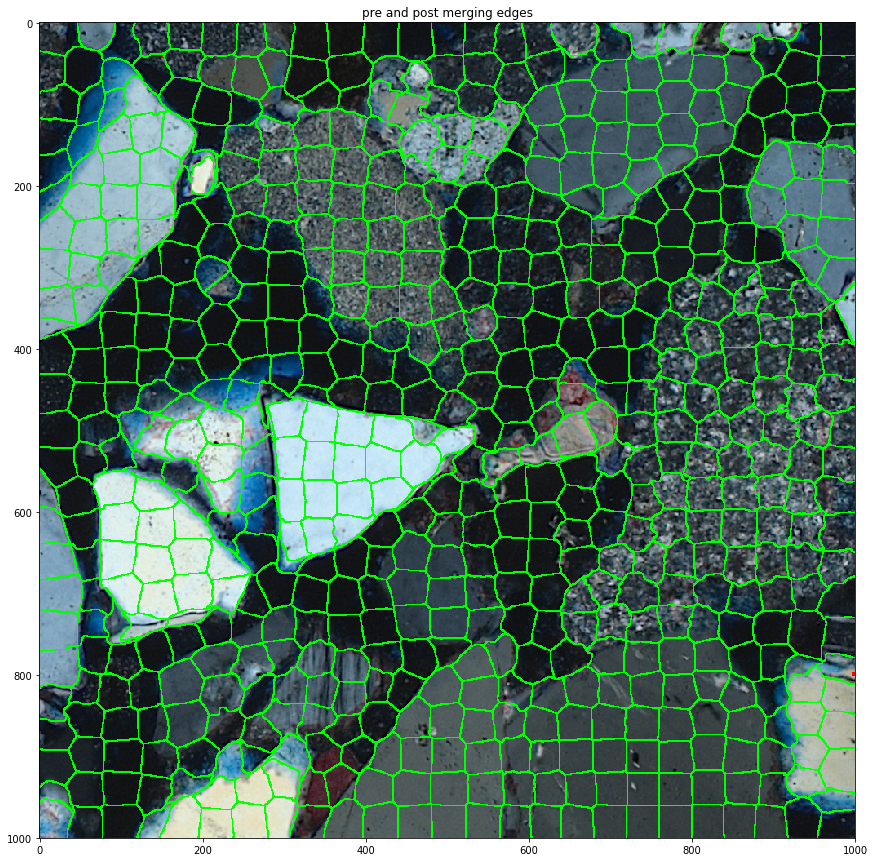

In [0]:
# show both images and the segmentation
for IP in IP_white, IP_polar:
    segment_obj.plot(option='default', back_img=IP.imgs['original'])

### Clustering (old)

In [0]:

color_names = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
               'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3']

def extract_color(Xs, Ys, IP_obj_white, IP_obj_polar):
    w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
    p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    return [*w_col_avg, *p_col_avg]

# ------------------------------------------------------------------  

col_grad_names = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
                  'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
                  'w_lapalce_avg', 'p_lapace_avg']

def extract_col_grad(Xs, Ys, IP_obj_white, IP_obj_polar):

    w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
    p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    w_lap_avg = IP_obj_white.imgs['laplace'][Ys, Xs].mean()
    p_lap_avg = IP_obj_polar.imgs['laplace'][Ys, Xs].mean()
    
    return [*w_col_avg, *p_col_avg, w_lap_avg, p_lap_avg]


# ------------------------------------------------------------------  

col_grad_std_names = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
                      'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
                      'w_lapalce_avg', 'p_lapace_avg', 'w_gry_std',
                      'p_gry_std']

def extract_col_grad_std(Xs, Ys, IP_obj_white, IP_obj_polar):

    w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
    p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    w_lap_avg = IP_obj_white.imgs['laplace'][Ys, Xs].mean()
    p_lap_avg = IP_obj_polar.imgs['laplace'][Ys, Xs].mean()
    w_gry_std = IP_obj_white.imgs['grey'][Ys, Xs].std()
    p_gry_std = IP_obj_polar.imgs['grey'][Ys, Xs].std()
    
    return [*w_col_avg, *p_col_avg, w_lap_avg, p_lap_avg, w_gry_std, p_gry_std]


# # ------------------------------------------------------------------  

# basic_extract_headings = ['w_gab_avg', 'w_gab_std', 'p_gab_avg', 'p_gab_std',
#                           'w_col_avg', 'w_col_std', 'p_col_avg', 'p_col_std']

# def basic_extract(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#             w_gab_avg = IP_obj_white.imgs['gabor'][Ys, Xs].mean()
#             w_gab_std = IP_obj_white.imgs['gabor'][Ys, Xs].std()
#             p_gab_avg = IP_obj_polar.imgs['gabor'][Ys, Xs].mean()
#             p_gab_std = IP_obj_polar.imgs['gabor'][Ys, Xs].std()
            
#             w_col_avg = IP_obj_white.imgs['original'][Ys, Xs].mean()
#             w_col_std = IP_obj_white.imgs['original'][Ys, Xs].std()
#             p_col_avg = IP_obj_polar.imgs['original'][Ys, Xs].mean()
#             p_col_std = IP_obj_polar.imgs['original'][Ys, Xs].std()
            
#             return [w_gab_avg,
#                     w_gab_std,
#                     p_gab_avg,
#                     p_gab_std,
#                     w_col_avg,
#                     w_col_std,
#                     p_col_avg,
#                     p_col_std]


# # ------------------------------------------------------------------     
        
# extract_color_white_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3']

# def extract_color_white(Xs, Ys, IP_obj_white, IP_obj_polar):

#     w_col_avg = IP_obj_white.imgs['original'][Ys, Xs].mean(axis=0)
    
#     return [*w_col_avg]

# # ------------------------------------------------------------------

# extract_col_gab_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
#                             'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
#                             'w_gab_avg', 'p_gab_avg']

# def extract_col_gab(Xs, Ys, IP_obj_white, IP_obj_polar):

#     w_col_avg = IP_obj_white.imgs['original'][Ys, Xs].mean(axis=0)
#     p_col_avg = IP_obj_polar.imgs['original'][Ys, Xs].mean(axis=0)
#     w_gab_avg = IP_obj_white.imgs['gabor'][Ys, Xs].mean()
#     p_gab_avg = IP_obj_polar.imgs['gabor'][Ys, Xs].mean()
    
#     return [*w_col_avg, *p_col_avg, w_gab_avg, p_gab_avg]

# # ------------------------------------------------------------------

# extract_grey_avg_std_headings = ['w_gry_avg', 'w_gry_std', 'p_gry_avg',
#                                  'p_gry_std']

# def extract_grey_avg_std(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_gry_avg = IP_obj_white.imgs['med_grey'][Ys, Xs].mean()
#     w_gry_std = IP_obj_white.imgs['med_grey'][Ys, Xs].std()
#     p_gry_avg = IP_obj_polar.imgs['med_grey'][Ys, Xs].mean()
#     p_gry_std = IP_obj_polar.imgs['med_grey'][Ys, Xs].std()

#     return [w_gry_avg, w_gry_std, p_gry_avg, p_gry_std]
    
# # ------------------------------------------------------------------    

col_hist_names = ['white_red_%i'%i for i in range(10)] + \
                      ['white_green_%i'%i for i in range(10)] + \
                      ['white_blue_%i'%i for i in range(10)] + \
                      ['polar_red_%i'%i for i in range(10)] + \
                      ['polar_green_%i'%i for i in range(10)] + \
                      ['polar_blue_%i'%i for i in range(10)]

def extract_col_hist(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    w_rgbs = IP_obj_white.imgs['gauss'][Ys, Xs]
    p_rgbs = IP_obj_polar.imgs['gauss'][Ys, Xs]
    
    hists = []
    for rgbs in w_rgbs, p_rgbs:
        for i in range(3):
            hists.append(np.histogram(rgbs[:, i], bins=10,
                                      range=(0., 1.), density=True)[0])
    return np.hstack(hists)
        
# # ------------------------------------------------------------------    

grey_hist_names = ['white_%i'%i for i in range(5)] + \
                  ['polar_%i'%i for i in range(5)]

def extract_grey_hist(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    w_rgbs = IP_obj_white.imgs['grey'][Ys, Xs]
    p_rgbs = IP_obj_polar.imgs['grey'][Ys, Xs]
    
    hists = []
    for rgbs in w_rgbs, p_rgbs:
        hists.append(np.histogram(rgbs, bins=5,
                                  range=(0., 1.), density=True)[0])
    return np.hstack(hists)

# # ------------------------------------------------------------------    

# # feat_headings = ['white_red_%i'%i for i in range(10)] + \
# #                 ['white_green_%i'%i for i in range(10)] + \
# #                 ['white_blue_%i'%i for i in range(10)]

# def extract_col_hist_white(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     rgbs = IP_obj_white.imgs['original'][Ys, Xs]
#     hists = [np.histogram(rgbs[:, 0], bins=10, range=(0., 1.), density=True)[0]
#              for i in range(3)]
    
#     return np.hstack(hists)   
    
# # ------------------------------------------------------------------   
    
# # feat_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
# #                  'w_sch_avg_1', 'w_sch_avg_2', 'w_sch_avg_3']
    
# def extract_grad_white(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_avg = IP_obj_white.imgs['original'][Ys, Xs].mean(axis=0)
#     w_sch_avg = IP_obj_white.imgs['scharr'][Ys, Xs].mean(axis=0)
    
#     return [*w_col_avg, *w_sch_avg]
    
# # ------------------------------------------------------------------     
        
# # feat_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
# #                  'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
# #                  'w_lap_avg_1', 'w_lap_avg_2', 'w_lap_avg_3',
# #                  'p_lap_avg_1', 'p_lap_avg_2', 'p_lap_avg_3']
# # feat_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
# #                  'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
# #                  'w_lap_avg', 'p_lap_avg']

# def extract_col_and_grad(Xs, Ys, IP_obj_white, IP_obj_polar):

#     w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
#     p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    
#     w_lap_avg = IP_obj_white.imgs['laplace'][Ys, Xs].mean()
#     p_lap_avg = IP_obj_polar.imgs['laplace'][Ys, Xs].mean()
    
#     return [*w_col_avg, *p_col_avg, w_lap_avg, p_lap_avg]

# # ------------------------------------------------------------------     
        
# # feat_headings = ['w_lap_avg_1', 'w_lap_avg_2', 'w_lap_avg_3',
# #                  'p_lap_avg_1', 'p_lap_avg_2', 'p_lap_avg_3']

# def extract_grad(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_lap_avg = IP_obj_white.imgs['laplace'][Ys, Xs].mean(axis=0)
#     p_lap_avg = IP_obj_polar.imgs['laplace'][Ys, Xs].mean(axis=0)
    
#     return [*w_lap_avg, *p_lap_avg]

# # ------------------------------------------------------------------  

# # feat_headings = ['w_hog_avg', 'p_hog_avg']

# def extract_hog(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_hog_avg = IP_obj_white.imgs['hog'][Ys, Xs].mean(axis=0)
#     p_hog_avg = IP_obj_polar.imgs['hog'][Ys, Xs].mean(axis=0)
    
#     return [w_hog_avg, p_hog_avg]
    
# # ------------------------------------------------------------------  

# # feat_headings = ['w_hog_avg', 'p_hog_avg', 'w_lap_avg', 'p_lap_avg',
# #                  'w_sch_avg', 'p_sch_avg']

# def extract_all_texture(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_hog_avg = IP_obj_white.imgs['hog'][Ys, Xs].mean()
#     p_hog_avg = IP_obj_polar.imgs['hog'][Ys, Xs].mean()
#     w_lap_avg = IP_obj_white.imgs['laplace'][Ys, Xs].mean()
#     p_lap_avg = IP_obj_polar.imgs['laplace'][Ys, Xs].mean()
#     w_sch_avg = IP_obj_white.imgs['scharr'][Ys, Xs].mean()
#     p_sch_avg = IP_obj_polar.imgs['scharr'][Ys, Xs].mean()
    
#     return [w_hog_avg, p_hog_avg, w_lap_avg, p_lap_avg, w_sch_avg, p_sch_avg]
    
# # ------------------------------------------------------------------  

# # feat_headings = ['w_sch_avg', 'p_sch_avg']

# def extract_scharr(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_sch_avg = IP_obj_white.imgs['scharr'][Ys, Xs].mean()
#     p_sch_avg = IP_obj_polar.imgs['scharr'][Ys, Xs].mean()
    
#     return [w_sch_avg, p_sch_avg]
    
    
# # ------------------------------------------------------------------  

# # feat_headings = ['w_col_std_1', 'w_col_std_2', 'w_col_std_3',
# #                  'p_col_std_1', 'p_col_std_2', 'p_col_std_3']

# def extract_color_std(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_std = IP_obj_white.imgs['original'][Ys, Xs].std(axis=0)
#     p_col_std = IP_obj_polar.imgs['original'][Ys, Xs].std(axis=0)
    
#     return [*w_col_std, *p_col_std]

# # ------------------------------------------------------------------  

# # feat_headings = ['w_col_std_1', 'w_col_std_2', 'w_col_std_3',
# #                  'p_col_std_1', 'p_col_std_2', 'p_col_std_3',
# #                  'w_col_skw_1', 'w_col_skw_2', 'w_col_skw_3',
# #                  'p_col_skw_1', 'p_col_skw_2', 'p_col_skw_3']

# from scipy.stats import skew
# def extract_color_std_skew(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_std = IP_obj_white.imgs['original'][Ys, Xs].std(axis=0)
#     p_col_std = IP_obj_polar.imgs['original'][Ys, Xs].std(axis=0)
#     w_col_skw = skew(IP_obj_white.imgs['original'][Ys, Xs], axis=0)/20
#     P_col_skw = skew(IP_obj_polar.imgs['original'][Ys, Xs], axis=0)/20

    
#     return [*w_col_std, *p_col_std, *w_col_skw, *P_col_skw]

# # ------------------------------------------------------------------  
    
# # feat_headings = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
# #                  'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
# #                  'w_col_std_1', 'w_col_std_2', 'w_col_std_3',
# #                  'p_col_std_1', 'p_col_std_2', 'p_col_std_3']

# from scipy.stats import skew
# def extract_color_avg_std(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
#     p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
#     w_col_std = IP_obj_white.imgs['original'][Ys, Xs].std(axis=0)
#     p_col_std = IP_obj_polar.imgs['original'][Ys, Xs].std(axis=0)
    
#     return [*w_col_avg, *p_col_avg, *w_col_std, *p_col_std]


# # ------------------------------------------------------------------ 

# extract_col_lap_gab_headings = ['w_col_avg_1','w_col_avg_2', 'w_col_avg_3',
#                                 'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
#                                 'w_lap_avg', 'p_lap_avg', 'w_gab_avg', 
#                                 'p_gab_avg']

# def extract_col_lap_gab(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
#     p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    
#     w_lap_avg = IP_obj_white.imgs['lap'][Ys, Xs].mean()
#     p_lap_avg = IP_obj_polar.imgs['lap'][Ys, Xs].mean()
    
#     w_gab_avg = IP_obj_white.imgs['gabor'][Ys, Xs].mean()
#     p_gab_avg = IP_obj_polar.imgs['gabor'][Ys, Xs].mean()
    
    
#     return [*w_col_avg, *p_col_avg, w_lap_avg, p_lap_avg, w_gab_avg, p_gab_avg]

# # ------------------------------------------------------------------ 

# extract_col_canyblur_headings = ['w_col_avg_1','w_col_avg_2', 'w_col_avg_3',
#                                  'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3',
#                                  'w_cab_avg', 'p_cab_avg']

# def extract_col_canyblur(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
#     p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    
#     w_cab_avg = IP_obj_white.imgs['cany_blur'][Ys, Xs].mean()
# #     w_cab_std = IP_obj_white.imgs['cany_blur'][Ys, Xs].std()
#     p_cab_avg = IP_obj_polar.imgs['cany_blur'][Ys, Xs].mean()
# #     p_cab_std = IP_obj_polar.imgs['cany_blur'][Ys, Xs].std()
    
    
#     return [*w_col_avg, *p_col_avg, w_cab_avg, p_cab_avg]


# # ------------------------------------------------------------------

# extract_col_hsv_rgb_headings = ['w_col_rgb_1','w_col_rgb_2', 'w_col_rgb_3',
#                                 'p_col_rgb_1', 'p_col_rgb_2', 'p_col_rgb_3',
#                                 'w_col_hsv_1','w_col_hsv_2', 'w_col_hsv_3',
#                                 'p_col_hsv_1', 'p_col_hsv_2', 'p_col_hsv_3']

# def extract_col_hsv_rgb(Xs, Ys, IP_obj_white, IP_obj_polar):
    
#     w_col_rgb = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
#     p_col_rgb = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    
#     w_col_hsv = IP_obj_white.imgs['gauss hsv'][Ys, Xs].mean(axis=0)
#     p_col_hsv = IP_obj_polar.imgs['gauss hsv'][Ys, Xs].mean(axis=0)
    
    
#     return [*w_col_rgb, *p_col_rgb, *w_col_hsv, *p_col_hsv]


In [0]:
def edge_conf_scharr(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    w_sch_avg = IP_obj_white.imgs['scharr'][Ys, Xs].mean()
    p_sch_avg = IP_obj_polar.imgs['scharr'][Ys, Xs].mean()
    avg = np.mean([w_sch_avg, p_sch_avg])
    
    return avg
    
    
def edge_conf_prewitt(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    w_prw_avg = IP_obj_white.imgs['prewitt'][Ys, Xs].mean()
    p_prw_avg = IP_obj_polar.imgs['prewitt'][Ys, Xs].mean()
    
    return np.mean([w_prw_avg, p_prw_avg])
    

def edge_conf_lap_frac(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    pixel_thresh = .1
    white_percent = (IP_obj_white.imgs['lap'][Ys, Xs] > pixel_thresh).mean()
    polar_percent = (IP_obj_polar.imgs['lap'][Ys, Xs] > pixel_thresh).mean()
    avg_percent = np.mean([white_percent, polar_percent])
    
    # 40% requiered to be an edge, 20% means absent
    return (avg_percent - 30) / 10


def edge_conf_scharr_frac(Xs, Ys, IP_obj_white, IP_obj_polar):
    
    thresh = .01
    w_sch_avg = (IP_obj_white.imgs['scharr'][Ys, Xs] > thresh).mean()
    p_sch_avg = (IP_obj_polar.imgs['scharr'][Ys, Xs] > thresh).mean()
    avg = np.mean([w_sch_avg, p_sch_avg])
    
    return (avg * 4) - 2

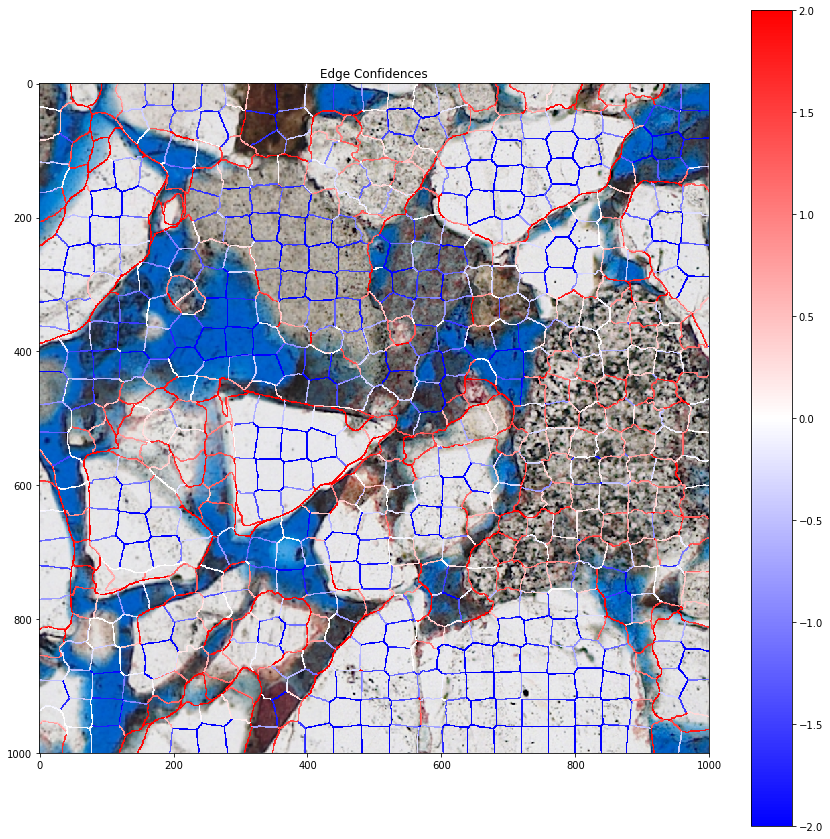

In [0]:
# find the edge confidences and plot it
segment_obj.edge_confidence(edge_conf_scharr_frac, [IP_white, IP_polar])
segment_obj.plot('edge_conf', back_img=IP_white.imgs['original'])

In [0]:
# # observe the edge confidence distribution
# IP_polar.plot('original')
# segments.plot('edge_conf', ax=plt.gca())

In [0]:
# old feature normalisation
# # normalise if wanted
# feats_pd -= feats_pd.mean()
# feats_pd /= feats_pd.std()
# feats = feats_pd.values
# feats_pd.describe()

### Clusting (New)

In [0]:
# add to the image preprocessor
for IP in IP_white, IP_polar:
    IP.grey_scale('grey')
    IP.grey_scale()
    IP.laplace(key='laplace')
    
# extract features
feats = segment_obj.feature_extraction(extract_func = extract_color,
                                       func_vars = [IP_white, IP_polar])
feats_pd = pd.DataFrame(feats, columns=color_names)
feats_pd.describe()

,w_col_avg_1,w_col_avg_2,w_col_avg_3,p_col_avg_1,p_col_avg_2,p_col_avg_3
count,625.000000,625.000000,625.000000,625.000000,625.000000,625.000000
mean,0.566203,0.610737,0.658895,0.256112,0.310079,0.340731
std,0.264456,0.202055,0.175449,0.195721,0.215987,0.219483
min,0.003186,0.167964,0.138779,0.013482,0.070248,0.074761
25%,0.371049,0.429550,0.519111,0.104811,0.138585,0.165634
50%,0.592782,0.598320,0.672521,0.215229,0.258992,0.289735
75%,0.822554,0.816103,0.821999,0.309999,0.364961,0.394540
max,0.906142,0.904932,0.915129,0.894623,0.931603,0.964799


In [0]:
# # old feature normalisation
# # normalise if wanted
# feats_pd -= feats_pd.mean()
# feats_pd /= feats_pd.std()
# feats = feats_pd.values
# feats_pd.describe()

Progress |###################################################| 0.3083 s



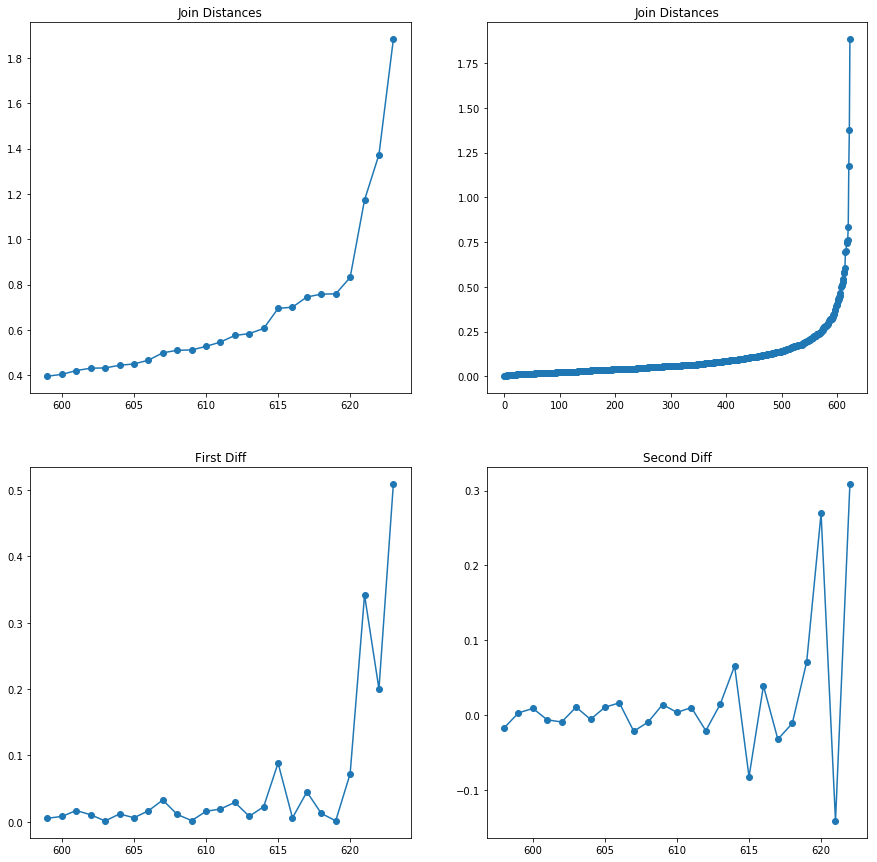

In [0]:
# cluster by AGNES
AGNES_obj = AGNES(feats)
AGNES_obj.iterate()
AGNES_obj.cluster_distance_plot('all')

In [0]:
# form the clustering
clustering = AGNES_obj.cluster_by_derivative(n_std=3., plot=False)
segment_obj.assign_clusters(clustering)

Clustering up to 2nd derivative 0.05530375860539227
Clustering into 10 segments


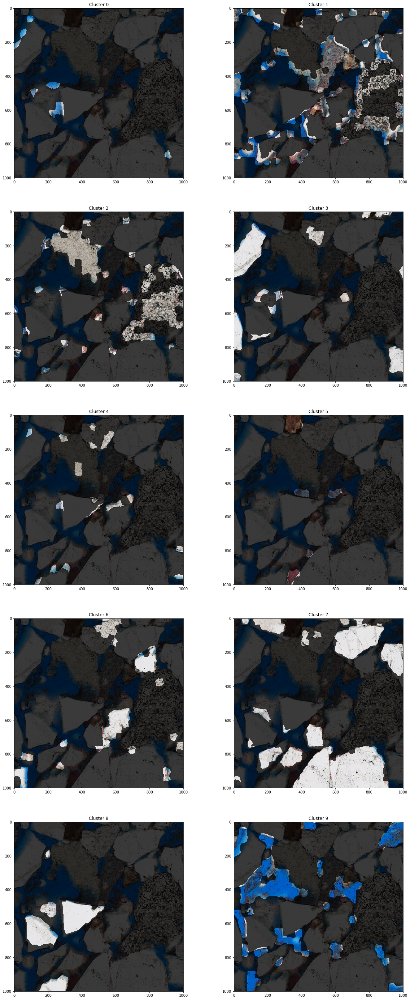

In [0]:
# plot all clusters
segment_obj.plot('cluster_all', back_img=IP_white.imgs['original'])

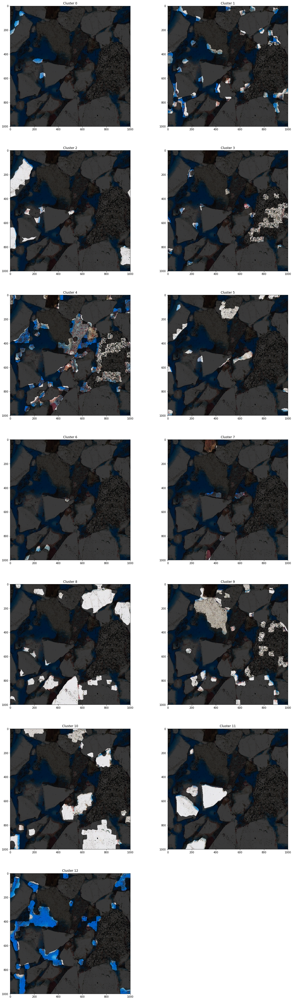

In [0]:
# plot all clusters
segment_obj.plot('cluster_all', back_img=IP_white.imgs['original'])

484 segments merged
Initalising 141 segments
Progress |###################################################| 12.4170 s



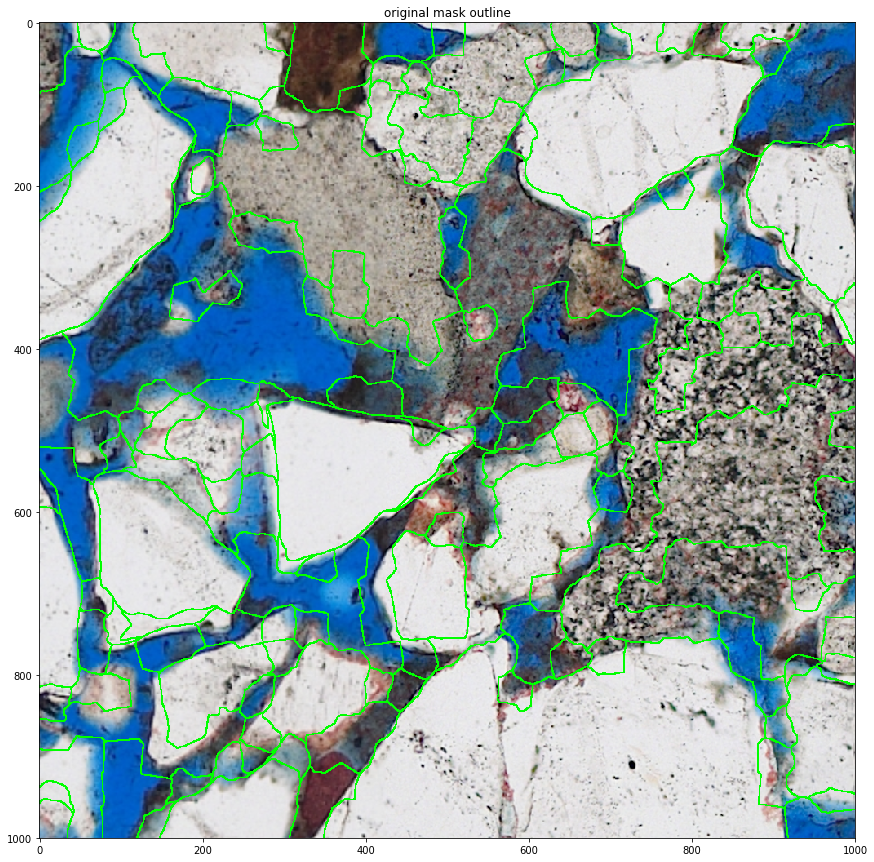

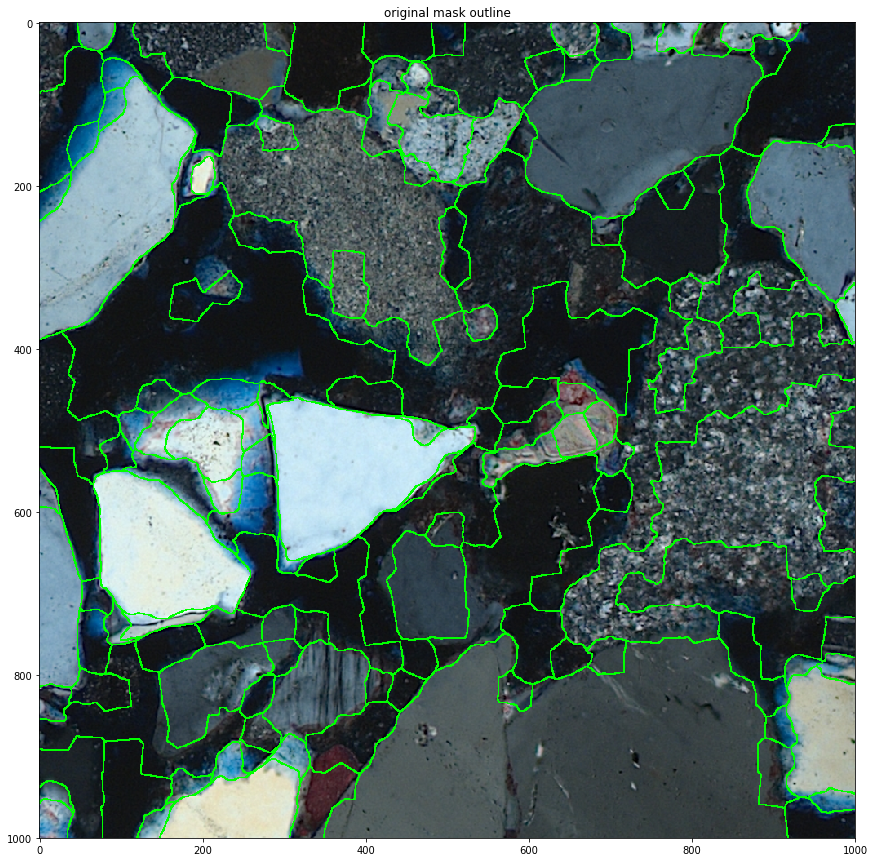

In [0]:
# merge connected segments
segment_obj.merge_by_cluster()

# plot the results
segment_obj.plot('merged_edges', back_img=IP_white.imgs['original'])
segment_obj.plot('merged_edges', back_img=IP_polar.imgs['original'])

### Cluster a second time

In [0]:
# extract features
feats = segment_obj.feature_extraction(extract_func = extract_color_both,
                                       func_vars = [IP_white, IP_polar])
pd.DataFrame(feats, columns=both_color_names).describe()

,w_col_avg_1,w_col_avg_2,w_col_avg_3,p_col_avg_1,p_col_avg_2,p_col_avg_3
count,74.000000,74.000000,74.000000,74.000000,74.000000,74.000000
mean,0.524110,0.579077,0.631895,0.278876,0.354338,0.398018
std,0.220078,0.167308,0.147170,0.189189,0.206653,0.212220
min,0.111513,0.217436,0.180977,0.070295,0.091487,0.100266
25%,0.367974,0.433921,0.532666,0.136567,0.170127,0.197148
50%,0.517551,0.585935,0.650114,0.224860,0.330269,0.392170
75%,0.728250,0.729476,0.743498,0.382535,0.463779,0.571887
max,0.859388,0.854086,0.868138,0.848528,0.875513,0.892070


Progress |###################################################| 0.0217 s



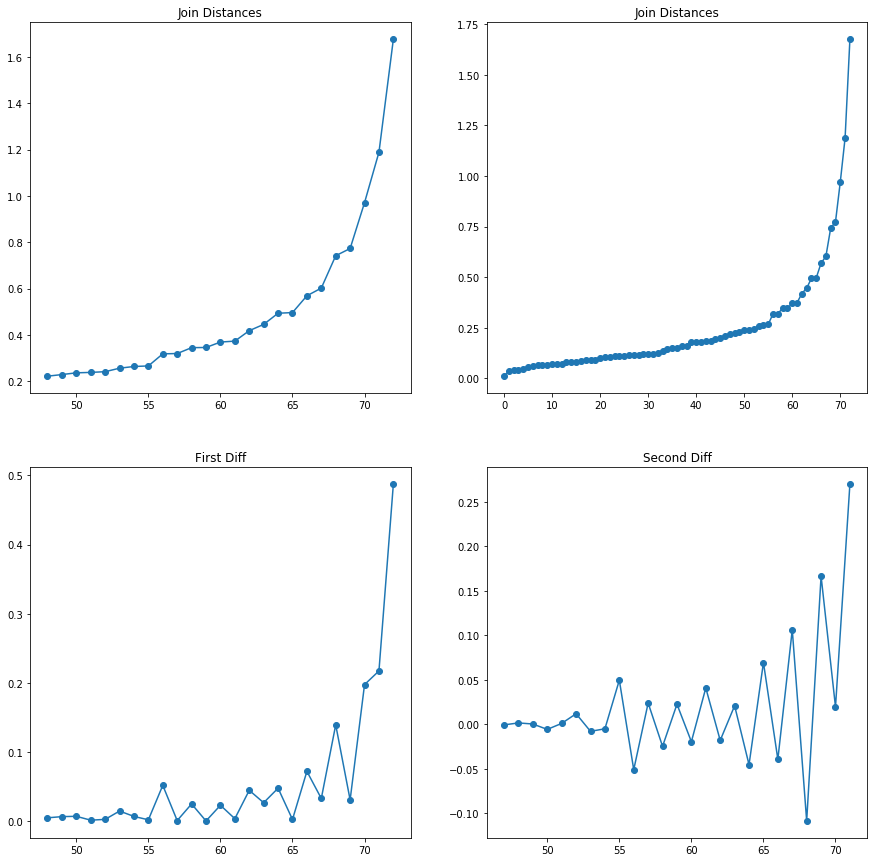

In [0]:
# cluster by AGNES
AGNES_obj = AGNES(feats)
AGNES_obj.iterate()
AGNES_obj.cluster_distance_plot('all')

In [0]:
# form the clustering
clustering = AGNES_obj.cluster_by_derivative(n_std=1., plot=False)
segment_obj.assign_clusters(clustering)

Clustering up to 2nd derivative 0.04460578608962774
Clustering into 18 segments


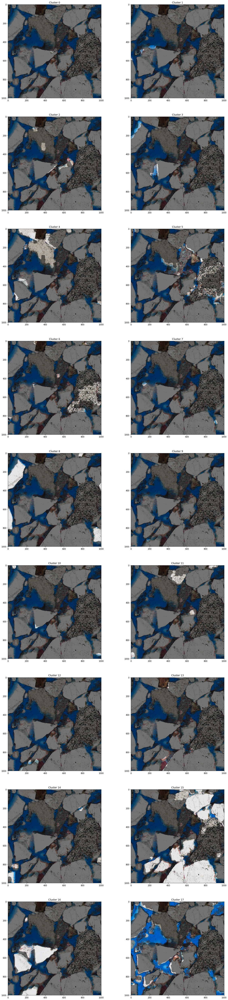

In [0]:
# plot all clusters
segment_obj.plot('cluster_all', back_img=IP_white.imgs['original'])

25 segments merged
Initalising 79 segments
Progress |###################################################| 7.2650 s



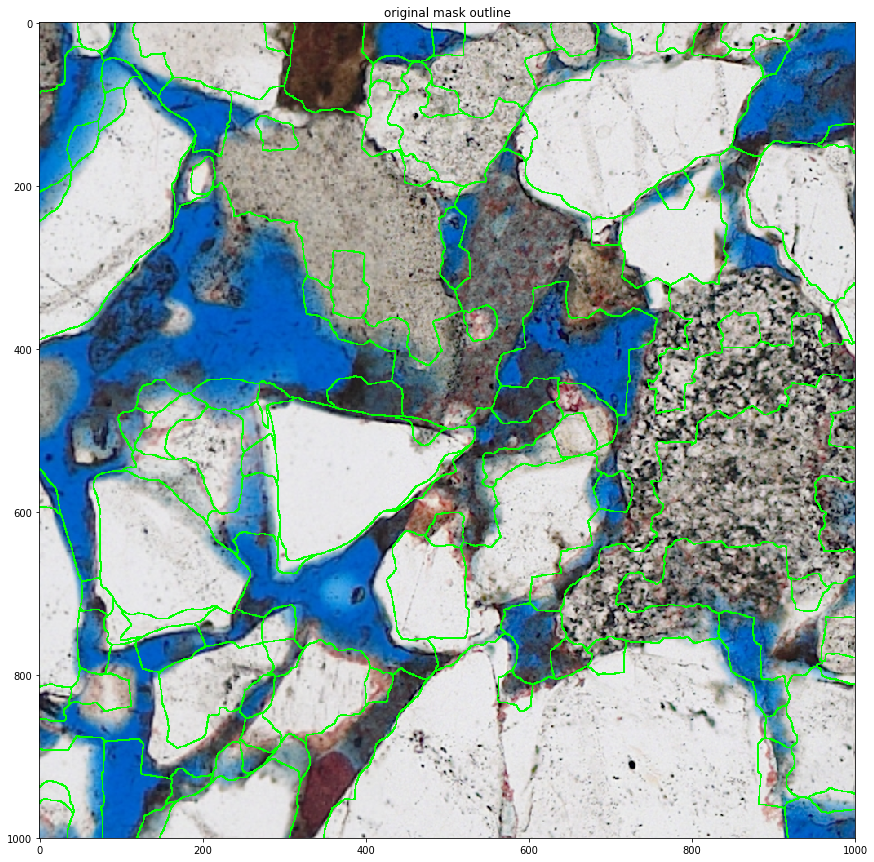

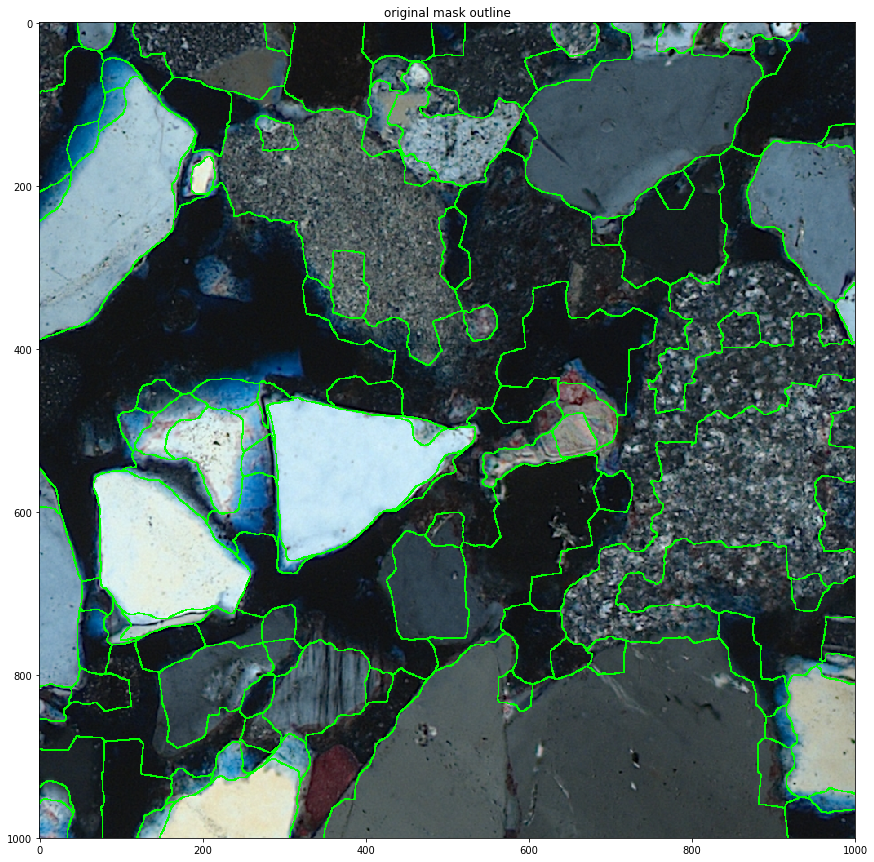

In [0]:
# merge connected segments
segment_obj.merge_by_cluster()

# plot the results
segment_obj.plot('merged_edges', back_img=IP_white.imgs['original'])
segment_obj.plot('merged_edges', back_img=IP_polar.imgs['original'])

In [0]:
# save the masks
# np.savetxt('/content/masks/both_30_30_merged_6_channel_color.txt', segments.mask)
# np.save('/content/masks/both_30_30_merged_6_channel_color_groupings.npy', segments.seg_clusters)

### Segment Analysis

In [0]:
# extract mask and clustering
tx2_mask = segment_obj.mask
tx2_clusters = segment_obj.get_cluster_mask()

In [0]:
# tx2_clusters = SA_obj.clusters
SA_obj = Segment_Analyser(IP_white.imgs['original'],
                          tx2_mask,
                          tx2_clusters)

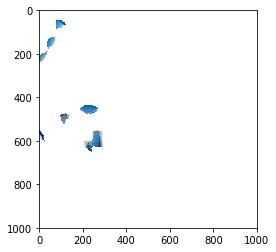

Currently labelled  0 
Give a new label (leave blank to unchange):
pore


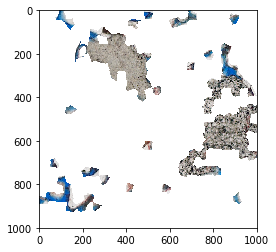

Currently labelled  1 
Give a new label (leave blank to unchange):
rock 1


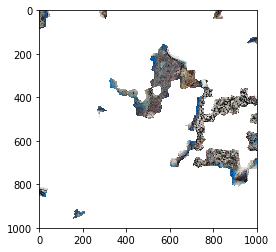

Currently labelled  2 
Give a new label (leave blank to unchange):
rock 2


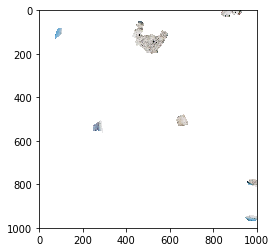

Currently labelled  3 
Give a new label (leave blank to unchange):
rock 3


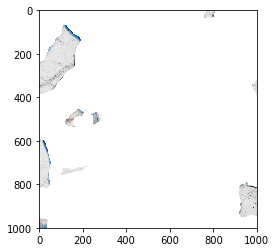

Currently labelled  4 
Give a new label (leave blank to unchange):
rock 4


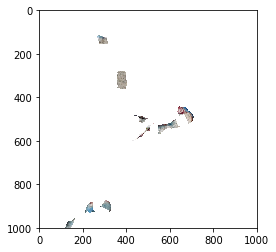

Currently labelled  5 
Give a new label (leave blank to unchange):
rock 5


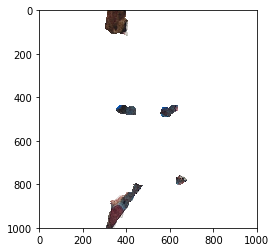

Currently labelled  6 
Give a new label (leave blank to unchange):
rock 6


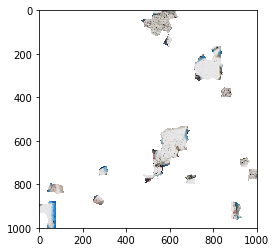

Currently labelled  7 
Give a new label (leave blank to unchange):
rock 7


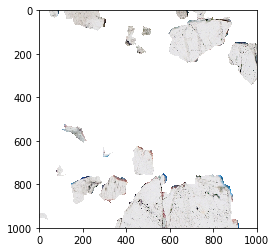

Currently labelled  8 
Give a new label (leave blank to unchange):
rock 8


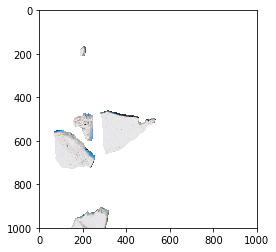

Currently labelled  9 
Give a new label (leave blank to unchange):
rock 10


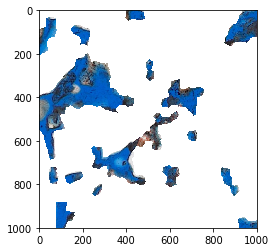

Currently labelled  10 
Give a new label (leave blank to unchange):
pore
Current Labels: ['pore', 'rock 1', 'rock 2', 'rock 3', 'rock 4', 'rock 5', 'rock 6', 'rock 7', 'rock 8', 'rock 10']


In [0]:
SA_obj.set_labels()

Tabel of Compositions
20.87 %	 pore
17.2 %	 rock 1
11.93 %	 rock 2
2.15 %	 rock 3
6.42 %	 rock 4
1.67 %	 rock 5
3.05 %	 rock 6
7.24 %	 rock 7
22.23 %	 rock 8
7.24 %	 rock 10


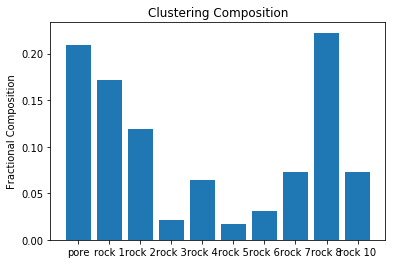

In [0]:
SA_obj.get_composition()

## Trying Mean Shift 

In [0]:
# initalise segement object
mask = np.loadtxt('/content/masks/both_30_30.txt').astype(np.int64)
segments = segment_groups(mask, None)
segments.enforce_size(min_size=60)

In [0]:
# feature extraction     
        
feat_headings_col = ['w_col_avg_1', 'w_col_avg_2', 'w_col_avg_3',
                     'p_col_avg_1', 'p_col_avg_2', 'p_col_avg_3']

def color_extract_both(Xs, Ys, IP_obj_white, IP_obj_polar):

    w_col_avg = IP_obj_white.imgs['gauss'][Ys, Xs].mean(axis=0)
    p_col_avg = IP_obj_polar.imgs['gauss'][Ys, Xs].mean(axis=0)
    
    return [*w_col_avg, *p_col_avg]


segments.extract = color_extract_both


# extract features
feats = segments.feature_extraction(IP_white, IP_polar)
feats_pd = pd.DataFrame(feats, columns=feat_headings_col)
feats_pd.describe()

In [0]:
from sklearn.cluster import MeanShift

# now lets try clustering with mean shift
MS_obj = MeanShift(bandwidth=0.2).fit(feats)
clustering = MS_obj.labels_
print('number of clusters:', np.unique(clustering).size)
print(clustering[:50])

In [0]:
segments.assign_clusters(clustering)
for clust in range(clustering.max()):
    IP_white.plot('original')
    segments.plot('cluster', cluster=clust, ax=plt.gca())

## Trying Watershed

So here I am going to try watershed and random walker segmentation algorithms using fill makers given fom MSLIC

In [0]:
# load images
IP_polar = Image_processor(path='/content/images/TX1_polarised_cropped.tif')
IP_white = Image_processor(path='/content/images/TX1_white_cropped.tif')

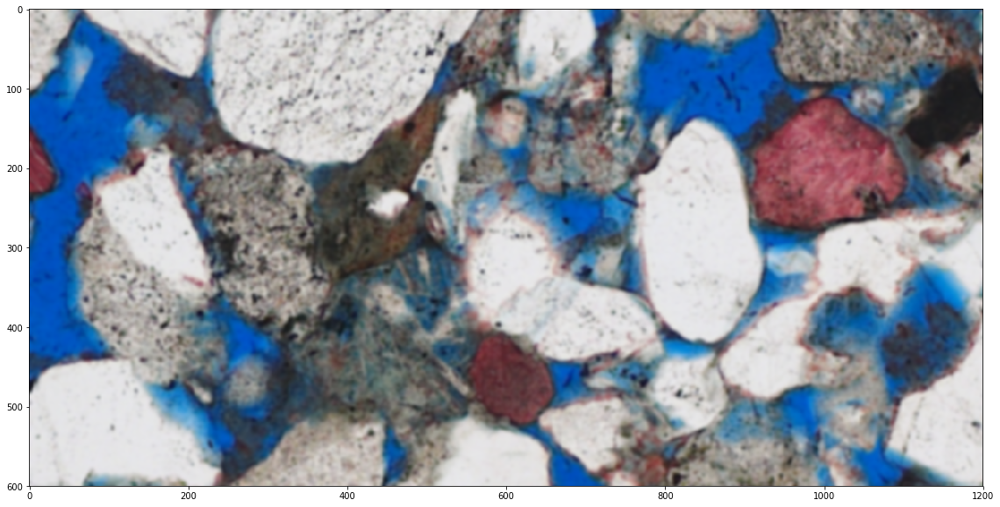

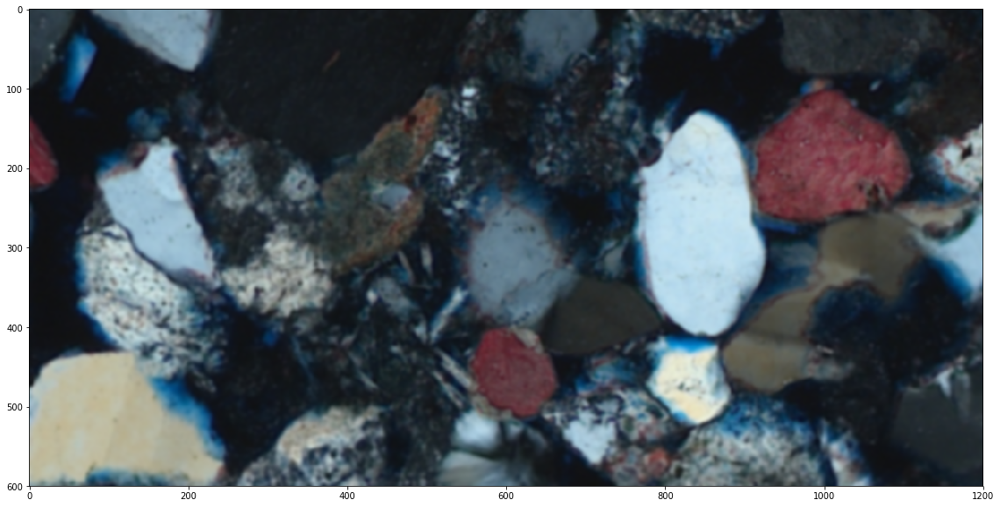

In [0]:
# preprocess
imgs = []
for IP in IP_white, IP_polar:
    imgs.append(IP.gauss(sigma=2, key='blur'))
    IP.plot('blur')

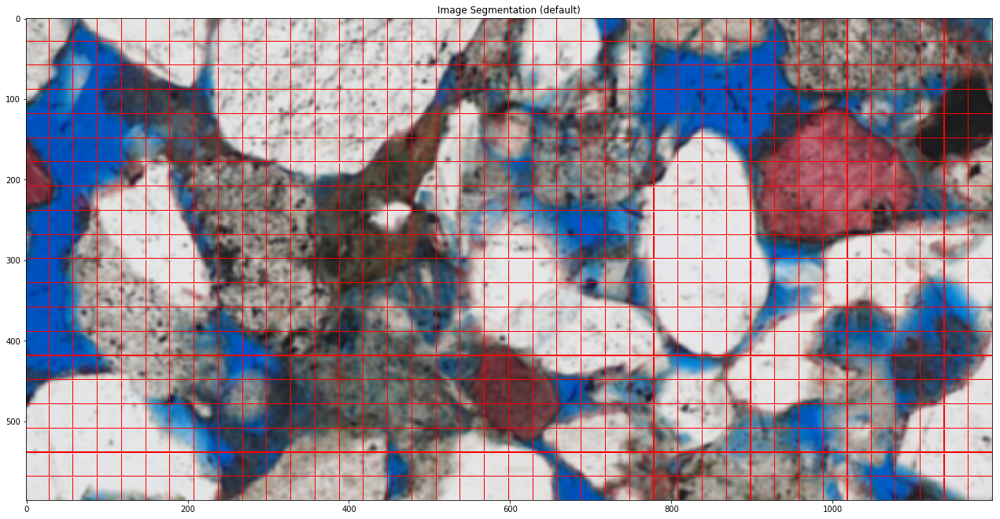

In [0]:
# do the SLIC segmentation
bin_grid = [int(1200/30), int(600/30)]
test_MSLIC = MSLIC_wrapper(imgs, bin_grid)
test_MSLIC.plot(obj_indexs=[0])

Progress |###################################################| 120.7780 s

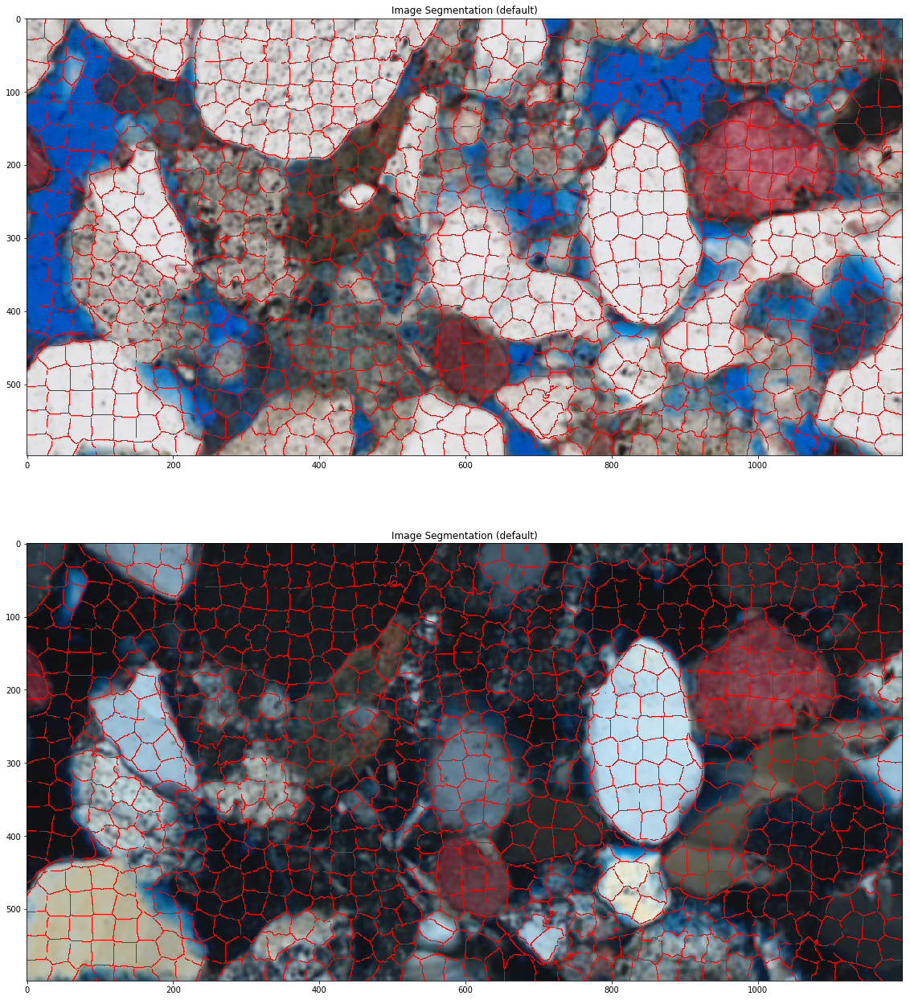

In [0]:
test_MSLIC.iterate(10)
test_MSLIC.plot(obj_indexs=[0, 1])

In [0]:
# extract centers
SLIC_obj = test_MSLIC.SLIC_objs[0]
centers = SLIC_obj.centroids[:, :2].numpy()
centers = centers.T.astype(int)

# make empty mask with centers
seeds = np.full([SLIC_obj.dim_y, SLIC_obj.dim_x], np.nan)
seeds[centers[1], centers[0]] = np.arange(centers.shape[-1])

array([[  12,   38,   66, ..., 1121, 1149, 1181],
       [  14,   16,   17, ...,  587,  588,  584]])

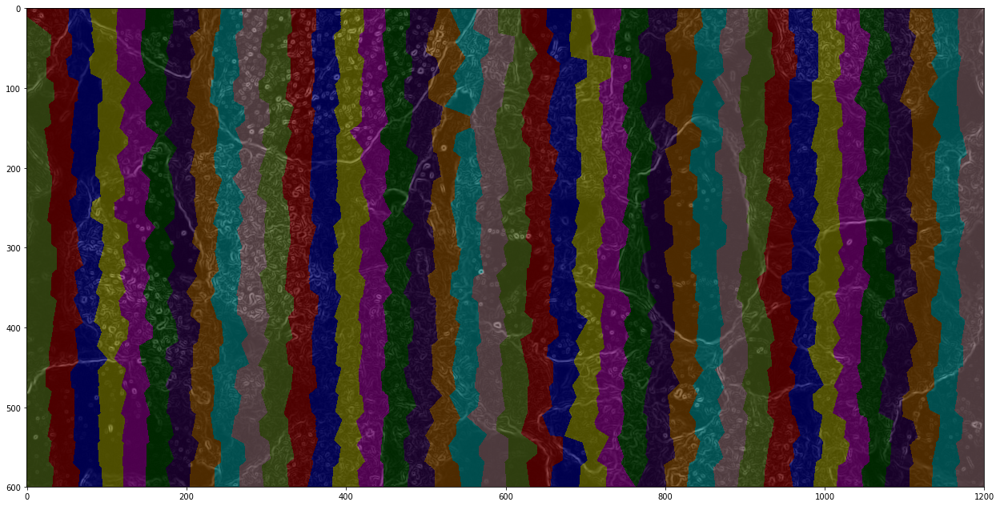

In [0]:
# try watershed
# from skimage.morphology import watershed

# IP_white.reset()
# # IP_white.sobel()
# img = IP_white.grey_scale()

# w0 = watershed(gs, seeds, compactness=.5)

# plt.figure(figsize=[22, 11])
# plt.imshow(color.label2rgb(w0, gs))

In [0]:
# # try random walker
# from skimage.segmentation import random_walker

# # IP_white.reset()
# # IP_white.sobel()

# img = IP_white.imgs['original']
# out = random_walker(img, seeds)
# print(out)
# # plt.imshow(color.label2rgb(w0, gs))


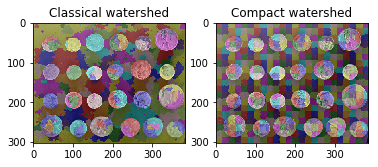

In [0]:
# example from https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_compact_watershed.html#sphx-glr-auto-examples-segmentation-plot-compact-watershed-py
import numpy as np
from skimage import data, util, filters, color
from skimage.morphology import watershed
import matplotlib.pyplot as plt

coins = data.coins()
edges = filters.sobel(coins)

grid = util.regular_grid(coins.shape, n_points=468)

seeds = np.zeros(coins.shape, dtype=int)
seeds[grid] = np.arange(seeds[grid].size).reshape(seeds[grid].shape) + 1

w0 = watershed(edges, seeds)
w1 = watershed(edges, seeds, compactness=0.01)

fig, (ax0, ax1) = plt.subplots(1, 2)

ax0.imshow(color.label2rgb(w0, coins))
ax0.set_title('Classical watershed')

ax1.imshow(color.label2rgb(w1, coins))
ax1.set_title('Compact watershed')

plt.show()

## Trying Random Walker

In [0]:
class my_random_walker(): # :p
    
    cd = np.array([[-1, 0], # left
                                 [0, 1], # up
                                 [1, 0], # right
                                 [0, -1]]) # down
    
    def __init__(self, img):
        "this probably wont work"
        self.img = img
        self._ydim, self._xdim = img.shape[:2]
        
        
    def _random_step(self, x, y, d_max=3):
        
        neighs = self._pixel_neighbours_cross(x, y,
                                              d=np.random.randint(1, d_max))
        dists = [self._pixel_diff(x, y, nx, ny) for nx, ny in neighs]
        cumsum = np.cumsum(dists)
        n_id = np.argmax(cumsum >  np.random.rand() * cumsum[-1])
        return neighs[n_id]
        
        
    def _pixel_diff(self, x1, y1, x2, y2):
        p1, p2 = self.img[y1, x1], self.img[y2, x2]
        return ((p1 - p2)**2).sum()
        
        
    def _pixel_neighbours_box(self, x, y):
        """
        Find the neighbours to the x and y pixel. This method is stored on the
        wrapper as it knows the dimensions of the whole image.
        """
        return np.array([(x_, y_) for x_ in range(x-1, x+2)
                                  for y_ in range(y-1, y+2)
                         if ((x != x_ or y != y_) and   # not the center
                             (0 <= x_ < self._xdim) and # not outside x range
                             (0 <= y_ < self._ydim))])  # not outside y range
        
    # cross
    def _pixel_neighbours_cross(self, x, y, d=1):
        """
        Find the neighbours to the x and y pixel. This method is stored on the
        wrapper as it knows the dimensions of the whole image.
        """
        return np.array([(x_, y_) 
                         if ((0 <= x_ < self._xdim) and # not outside x range
                             (0 <= y_ < self._ydim)) # not outside y range
                         else
                            (x, y)
                         for x_, y_ in ((x-d, y), (x, y+d),
                                        (x+d,y), (x, y-d))])
    
        
    def walk(self, x, y, n_steps, n_walks):
        "randomly walk from x,y for n_steps, returns a list of pixels reached"
        ends = []
        
#         bar = progress_bar(n_walks)
        for it in range(n_walks):
            pos = (x, y)
            for _ in range(n_steps):
                pos = self._random_step(*pos)
            ends.append(pos)
#             bar(it)
        return np.array(ends)
        

In [0]:
# extract centers
SLIC_obj = test_MSLIC.SLIC_objs[0]
centers = SLIC_obj.centroids[:, :2].numpy().astype(int)

In [0]:
# create walker obj
IP_white = Image_processor(path='/content/images/TX1_white_cropped.tif')
walker_obj = my_random_walker(IP_white.imgs['original'])

In [0]:
mask = np.loadtxt('/content/masks/both_30_30.txt').astype(np.int64)
walk_outcomes = []
bar = progress_bar(len(centers))
for n, cents in enumerate(centers):
    bar(n)
    points = walker_obj.walk(*cents, 100, 200)
    destinations = mask[points[:,1], points[:,0]]
    walk_outcomes.append(destinations)

Progress |###################################################| 1352.7078 s

In [0]:
walk_array = np.array(walk_outcomes)
np.savetxt('/content/masks/30_30_mask_walk_100_200.npy', walk_array)

In [0]:
to_merge = []
for n, arr in enumerate(walk_array):
    _ids, counts = np.unique(arr, return_counts=True)
    counts = counts.astype(float) / counts.sum()
    for c, _id in zip(counts, _ids):
        if _id != n:
            if c > .1:
                to_merge.append((n, _id))

In [0]:
len(to_merge)

229

In [0]:
# initalise segement object and remove small grains
segments = segment_groups(mask)
# segments.enforce_size(min_size=60)

Initalising 1248 segments
Progress |###################################################| 71.9240 s



In [0]:
segments._merge_segments(to_merge)

134 segments merged
Initalising 515 segments
Progress |###################################################| 30.0286 s



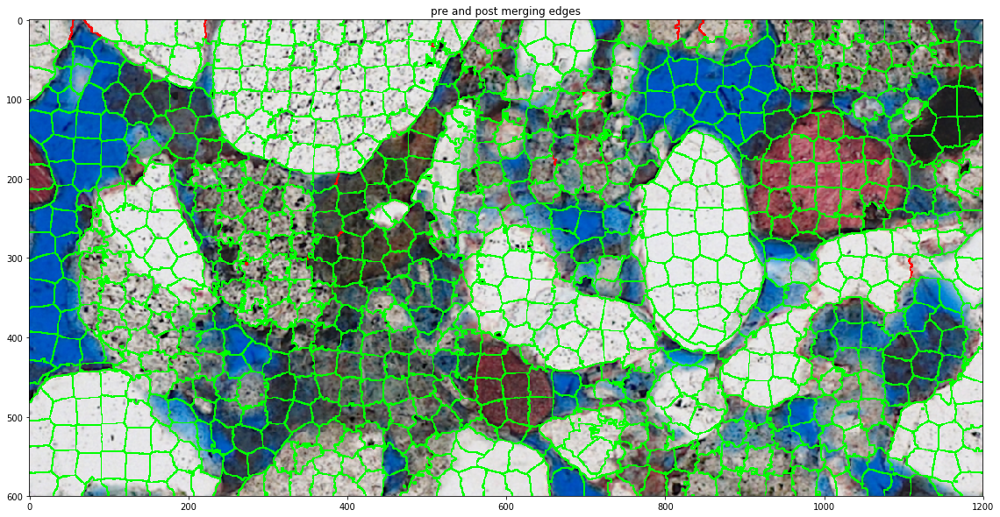

In [0]:
IP_white.plot('original')
segments.plot(ax=plt.gca())